### 1. Se pide:

A partir del archivo "USA_Housing.csv", realizar la regresión no lineal entre cada columna numérica con la columna 'price' utilizando:

- Regresión polinómica no lineal con grados del 2 al 10. ¿El score se estanca a partir de cierto grado?
- SVR

In [36]:
import pandas as pd
import numpy as np
# Import function to create training and test set splits
from sklearn.model_selection import train_test_split
# Import function to automatically create polynomial features! 
from sklearn.preprocessing import PolynomialFeatures
# Import Linear Regression
from sklearn.linear_model import LinearRegression
import matplotlib.pyplot as plt
from sklearn.svm import SVR
from sklearn import svm
from sklearn.metrics import r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler


In [37]:
df = pd.read_csv("../data/USA_Housing.csv")
df.head()

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price,Address
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06,"208 Michael Ferry Apt. 674\r\nLaurabury, NE 37..."
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06,"188 Johnson Views Suite 079\r\nLake Kathleen, ..."
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06,"9127 Elizabeth Stravenue\r\nDanieltown, WI 064..."
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06,USS Barnett\r\nFPO AP 44820
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05,USNS Raymond\r\nFPO AE 09386


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 7 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Avg. Area Income              5000 non-null   float64
 1   Avg. Area House Age           5000 non-null   float64
 2   Avg. Area Number of Rooms     5000 non-null   float64
 3   Avg. Area Number of Bedrooms  5000 non-null   float64
 4   Area Population               5000 non-null   float64
 5   Price                         5000 non-null   float64
 6   Address                       5000 non-null   object 
dtypes: float64(6), object(1)
memory usage: 273.6+ KB


In [6]:
df.columns

Index(['Avg. Area Income', 'Avg. Area House Age', 'Avg. Area Number of Rooms',
       'Avg. Area Number of Bedrooms', 'Area Population', 'Price', 'Address'],
      dtype='object')

In [3]:
colum_analize = ('Avg. Area Income',	'Avg. Area House Age',	'Avg. Area Number of Rooms','Avg. Area Number of Bedrooms',	'Area Population')

# Regresión polinómica no lineal con grados del 2 al 10. ¿El score se estanca a partir de cierto grado?

Price vs. Avg. Area Number of Rooms

In [38]:
# Divido el conjunto de datos
X_train, X_test, y_train, y_test = train_test_split(df['Avg. Area Number of Rooms'].values, df['Price'].values,test_size=0.2, random_state=7)

################
(4000, 3)
y_pred (4000,)
Score: 0.11880104919282486


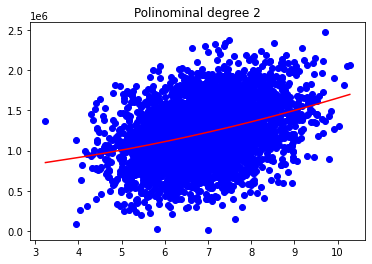

################
(4000, 4)
y_pred (4000,)
Score: 0.1188320122182086


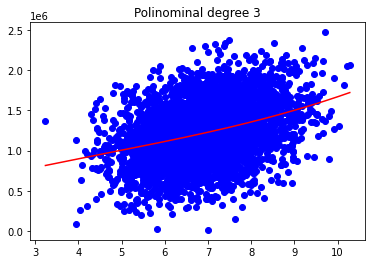

################
(4000, 5)
y_pred (4000,)
Score: 0.1191114045235826


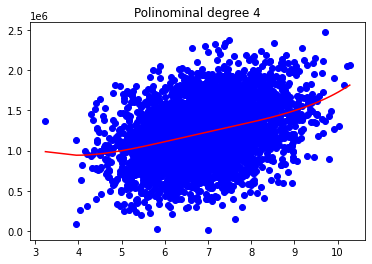

################
(4000, 6)
y_pred (4000,)
Score: 0.11919572670473366


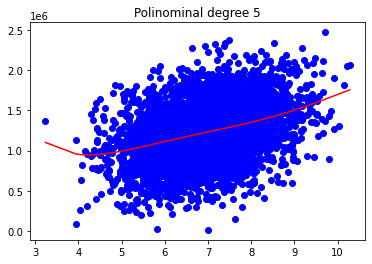

################
(4000, 7)
y_pred (4000,)
Score: 0.119225603764605


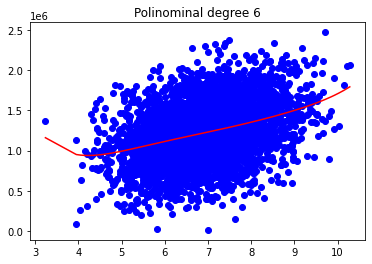

################
(4000, 8)
y_pred (4000,)
Score: 0.11924688048693699


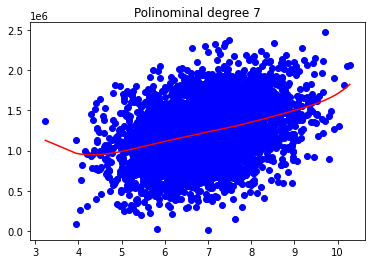

################
(4000, 9)
y_pred (4000,)
Score: 0.12071814060851194


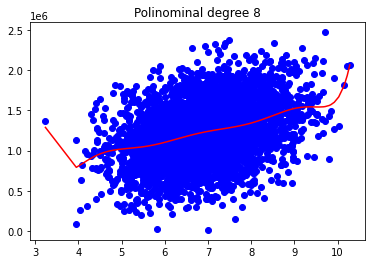

################
(4000, 10)
y_pred (4000,)
Score: 0.12103648684310342


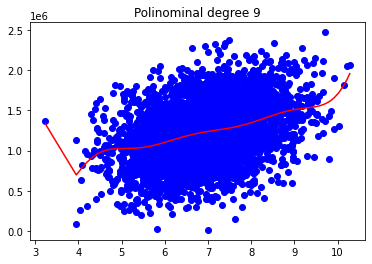

################
(4000, 11)
y_pred (4000,)
Score: 0.12138752843922684


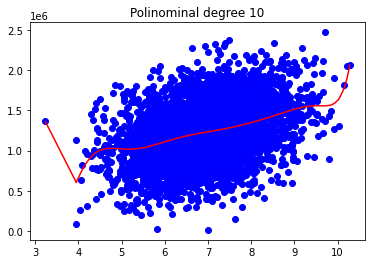

In [5]:
# Min and max degree of polynomials features to consider
degree_min = 2
degree_max = 10
# Make a pipeline model with polynomial transformation and LASSO regression with cross-validation, run it for increasing degree of polynomial (complexity of the model)
scores = []
for degree in range(degree_min,degree_max+1):
    print("################")
    polinominal_model = PolynomialFeatures(degree) 
    X_poly = polinominal_model.fit_transform(X_train.reshape(-1, 1),y_train)

    #######
    print(X_poly.shape)

    lin_reg_model = LinearRegression()
    lin_reg_model.fit(X_poly, y_train)
    y_pred = lin_reg_model.predict(X_poly)

    print("y_pred", y_pred.shape)
    print("Score:", r2_score(y_train, y_pred))

    X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train, y_train)))
    plt.scatter(X_train_to_show, y_train_to_show, color='b')
    X_train_to_show, y_pred = zip(*sorted(zip(X_train, y_pred)))
    plt.plot(X_train_to_show, y_pred, color='red')
    plt.title("Polinominal degree " + str(degree))
    plt.show()
    #input("Enter to next grade")

El máximo score se consigue con un polinomio de grado 10 (score = 0.12138752843922684)pero no se produce estancamiento y el incremento del score desde grado 2 hasta grado 10 es del 1%

Price vs. Avg. Area House Age

In [7]:
X1_train, X1_test, y1_train, y1_test = train_test_split(df['Avg. Area House Age'].values, df['Price'].values,test_size=0.2,random_state=7)

################
(4000, 3)
y1_pred (4000,)
Score: 0.2082674711170237


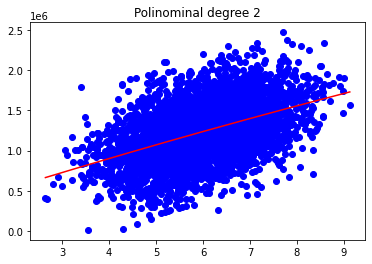

################
(4000, 4)
y1_pred (4000,)
Score: 0.20846871290333036


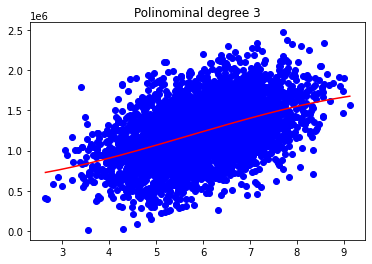

################
(4000, 5)
y1_pred (4000,)
Score: 0.20860660726571056


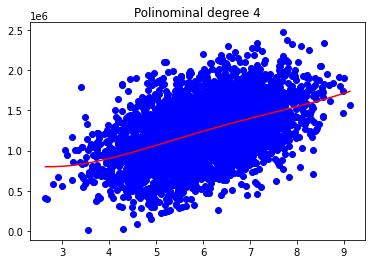

################
(4000, 6)
y1_pred (4000,)
Score: 0.20997282935770645


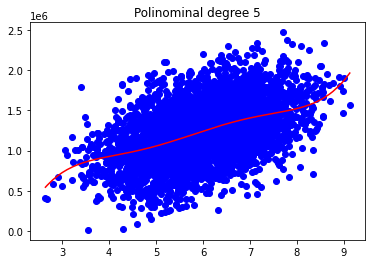

################
(4000, 7)
y1_pred (4000,)
Score: 0.21035055141457448


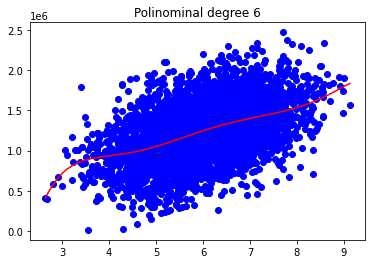

################
(4000, 8)
y1_pred (4000,)
Score: 0.21080214494725713


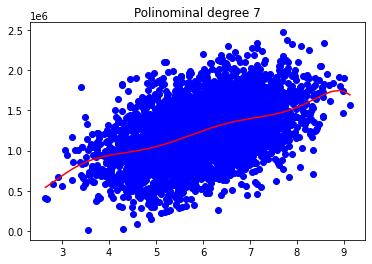

################
(4000, 9)
y1_pred (4000,)
Score: 0.2110858966822492


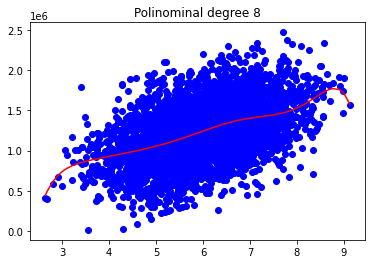

################
(4000, 10)
y1_pred (4000,)
Score: 0.21183774350161522


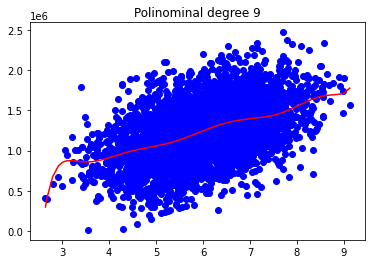

################
(4000, 11)
y1_pred (4000,)
Score: 0.21190240423254114


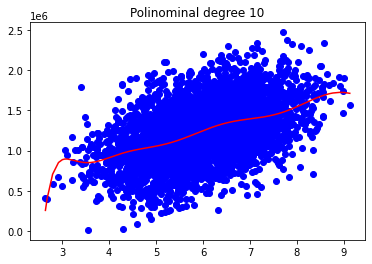

################
(4000, 12)
y1_pred (4000,)
Score: 0.21214709158753364


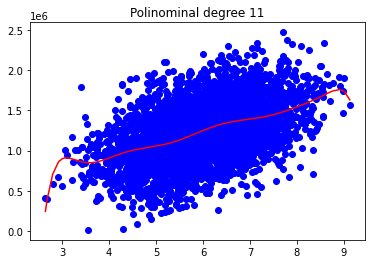

################
(4000, 13)
y1_pred (4000,)
Score: 0.21245920873436586


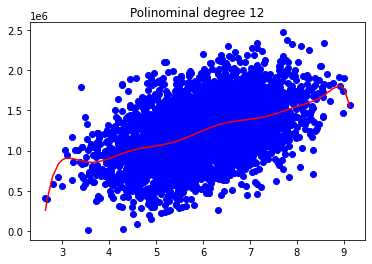

################
(4000, 14)
y1_pred (4000,)
Score: 0.21263921227683746


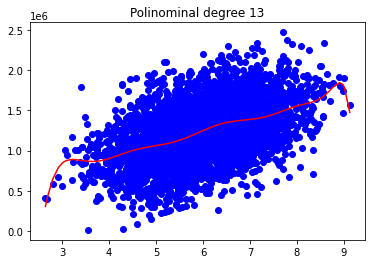

################
(4000, 15)
y1_pred (4000,)
Score: 0.21257116586625335


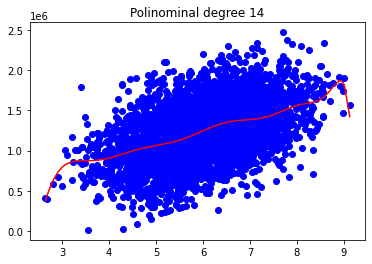

################
(4000, 16)
y1_pred (4000,)
Score: 0.2122924242416564


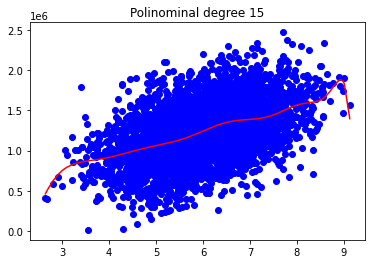

################
(4000, 17)
y1_pred (4000,)
Score: 0.21195249892738255


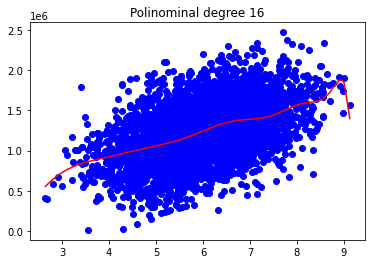

################
(4000, 18)
y1_pred (4000,)
Score: 0.21171233368943043


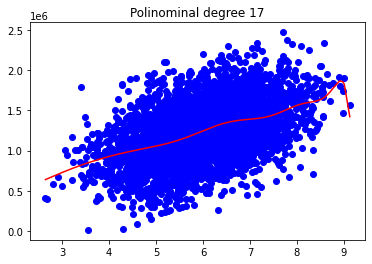

################
(4000, 19)
y1_pred (4000,)
Score: 0.21165210902883236


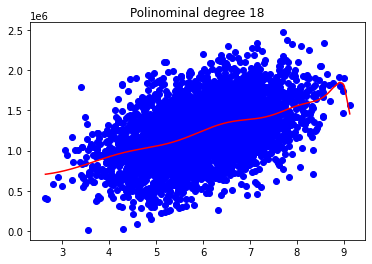

################
(4000, 20)
y1_pred (4000,)
Score: 0.2117351144582862


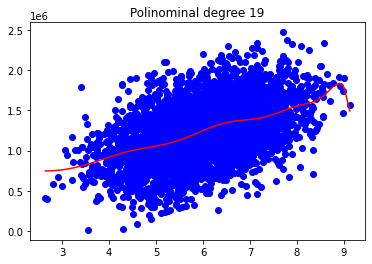

################
(4000, 21)
y1_pred (4000,)
Score: 0.2117863713138105


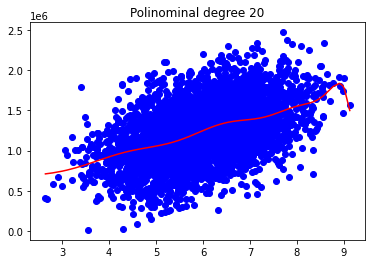

In [10]:
# Min and max degree of polynomials features to consider
degree_min = 2
degree_max = 20
# Make a pipeline model with polynomial transformation and LASSO regression with cross-validation, run it for increasing degree of polynomial (complexity of the model)
scores1 = []
for degree in range(degree_min,degree_max+1):
    print("################")
    polinominal_model1 = PolynomialFeatures(degree) 
    X1_poly = polinominal_model1.fit_transform(X1_train.reshape(-1, 1),y1_train)

    #######
    print(X1_poly.shape)

    lin_reg_model1 = LinearRegression()
    lin_reg_model1.fit(X1_poly, y1_train)
    y1_pred = lin_reg_model1.predict(X1_poly)

    print("y1_pred", y1_pred.shape)
    print("Score:", r2_score(y1_train, y1_pred))

    X1_train_to_show, y1_train_to_show = zip(*sorted(zip(X1_train, y1_train)))
    plt.scatter(X1_train_to_show, y1_train_to_show, color='b')
    X1_train_to_show, y1_pred = zip(*sorted(zip(X1_train, y1_pred)))
    plt.plot(X1_train_to_show, y1_pred, color='red')
    plt.title("Polinominal degree " + str(degree))
    plt.show()

El máximo score se consigue con un polinomio de grado 13 (score = 0.21263921227683746). A partir de aquí se reduce para polinomios de mayor grado. 

Ahora voy a intentar hacerlo con un for para realice la regresion no lineal polinomial entre Price y el resto de las columnas numéricas del dataframe. 

In [11]:
colum_analize = ('Avg. Area Income','Avg. Area House Age', 'Avg. Area Number of Rooms','Avg. Area Number of Bedrooms',	'Area Population')

################
(4000, 3)
y_pred (4000,)
Score: 0.41127743153932217


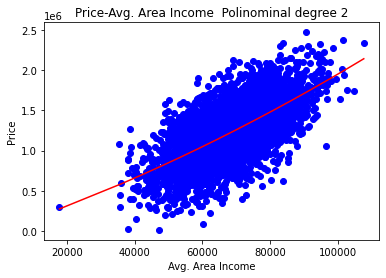

################
(4000, 4)
y_pred (4000,)
Score: 0.41127786956773327


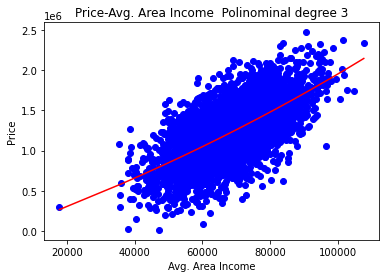

################
(4000, 5)
y_pred (4000,)
Score: 0.41131491110983354


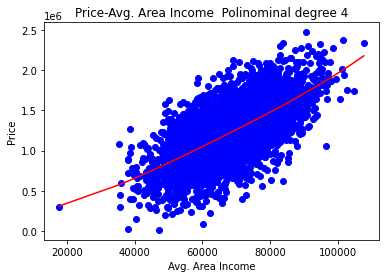

################
(4000, 6)
y_pred (4000,)
Score: 0.41132080358282797


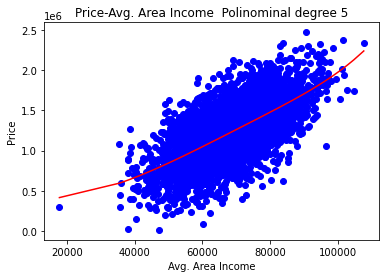

################
(4000, 7)
y_pred (4000,)
Score: 0.4110877593395228


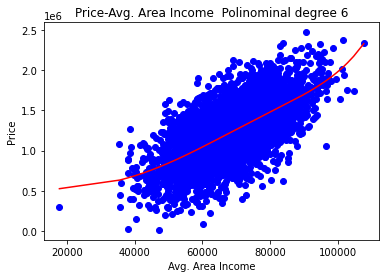

################
(4000, 8)
y_pred (4000,)
Score: 0.41027909248744143


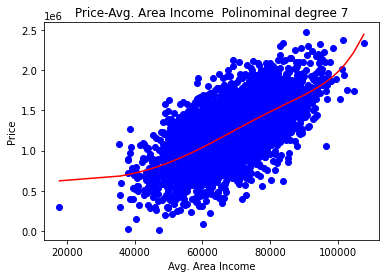

################
(4000, 9)
y_pred (4000,)
Score: 0.40848538647332544


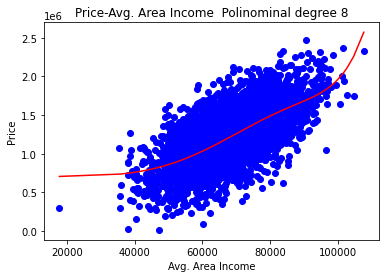

################
(4000, 10)
y_pred (4000,)
Score: 0.40533016150398304


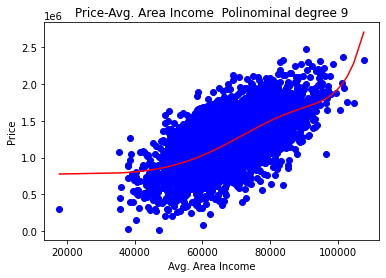

################
(4000, 11)
y_pred (4000,)
Score: 0.40054642668458806


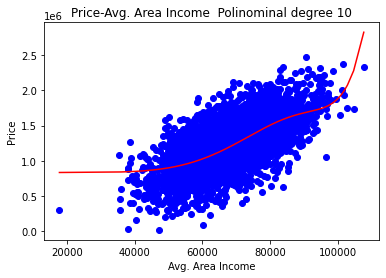

################
(4000, 3)
y_pred (4000,)
Score: 0.2082674711170237


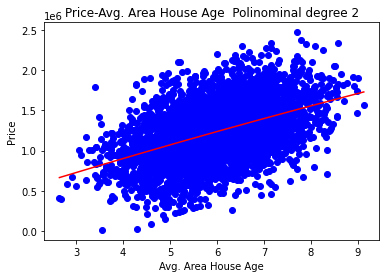

################
(4000, 4)
y_pred (4000,)
Score: 0.20846871290333036


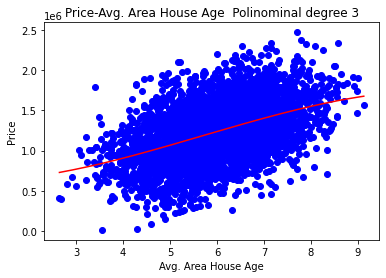

################
(4000, 5)
y_pred (4000,)
Score: 0.20860660726571056


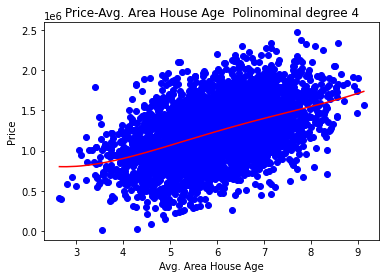

################
(4000, 6)
y_pred (4000,)
Score: 0.20997282935770645


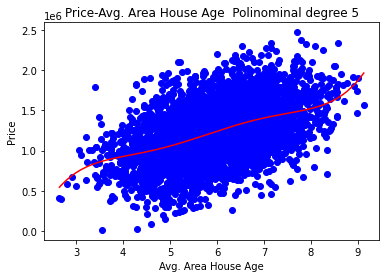

################
(4000, 7)
y_pred (4000,)
Score: 0.21035055141457448


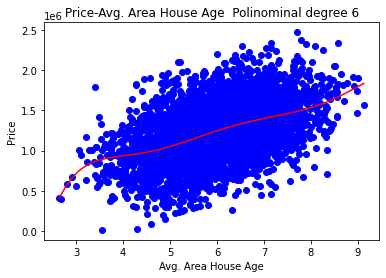

################
(4000, 8)
y_pred (4000,)
Score: 0.21080214494725713


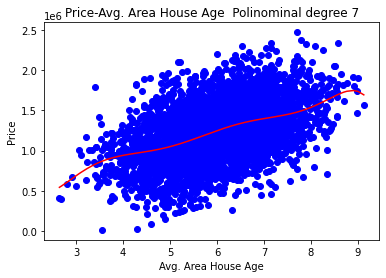

################
(4000, 9)
y_pred (4000,)
Score: 0.2110858966822492


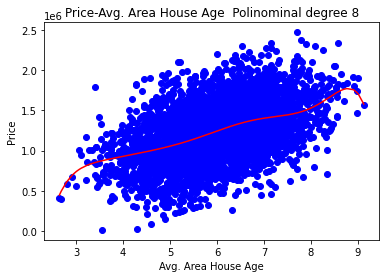

################
(4000, 10)
y_pred (4000,)
Score: 0.21183774350161522


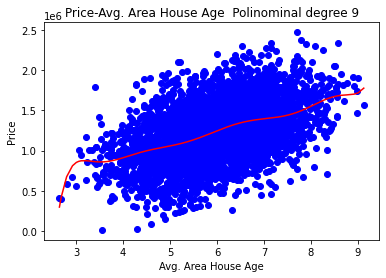

################
(4000, 11)
y_pred (4000,)
Score: 0.21190240423254114


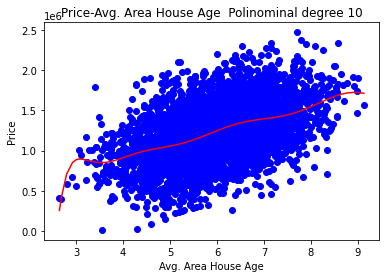

################
(4000, 3)
y_pred (4000,)
Score: 0.11880104919282486


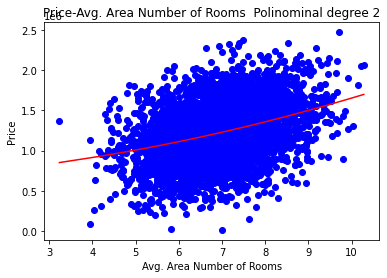

################
(4000, 4)
y_pred (4000,)
Score: 0.1188320122182086


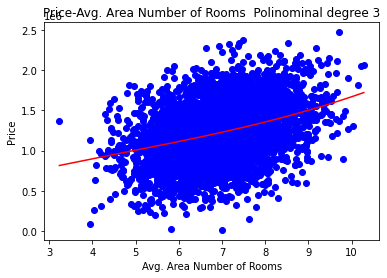

################
(4000, 5)
y_pred (4000,)
Score: 0.1191114045235826


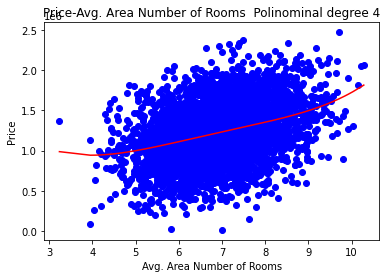

################
(4000, 6)
y_pred (4000,)
Score: 0.11919572670473366


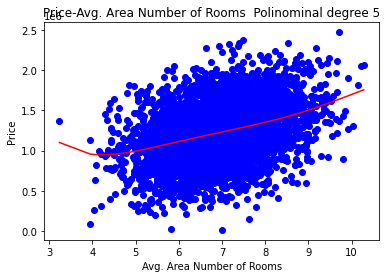

################
(4000, 7)
y_pred (4000,)
Score: 0.119225603764605


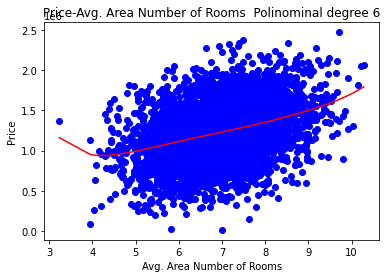

################
(4000, 8)
y_pred (4000,)
Score: 0.11924688048693699


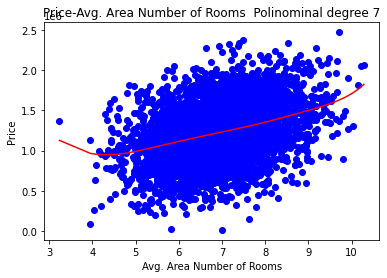

################
(4000, 9)
y_pred (4000,)
Score: 0.12071814060851194


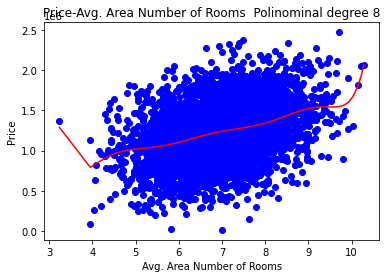

################
(4000, 10)
y_pred (4000,)
Score: 0.12103648684310342


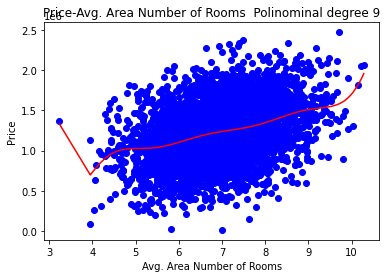

################
(4000, 11)
y_pred (4000,)
Score: 0.12138752843922684


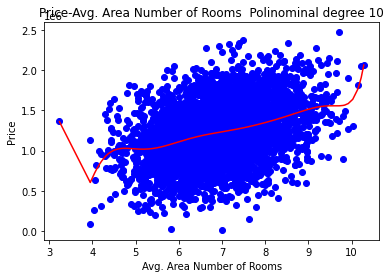

################
(4000, 3)
y_pred (4000,)
Score: 0.028856543977877958


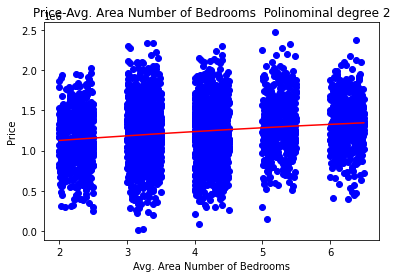

################
(4000, 4)
y_pred (4000,)
Score: 0.029103084316337013


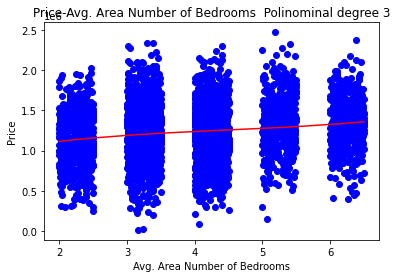

################
(4000, 5)
y_pred (4000,)
Score: 0.03529894471826045


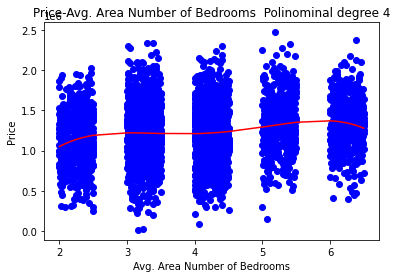

################
(4000, 6)
y_pred (4000,)
Score: 0.03538814199948026


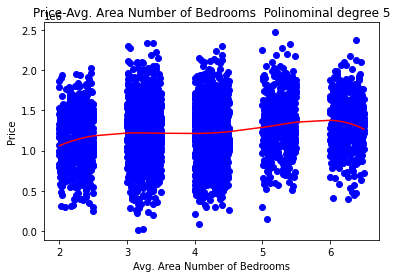

################
(4000, 7)
y_pred (4000,)
Score: 0.037029595704425544


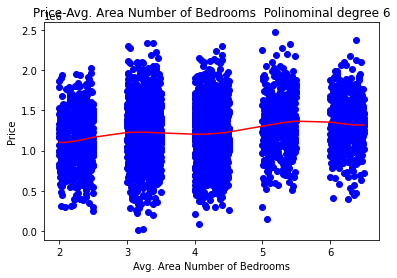

################
(4000, 8)
y_pred (4000,)
Score: 0.03703522070926302


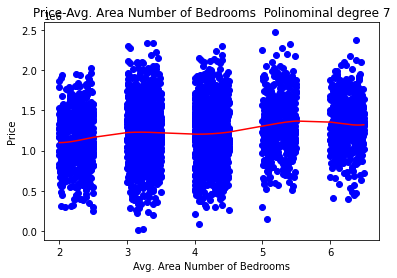

################
(4000, 9)
y_pred (4000,)
Score: 0.037120188199680215


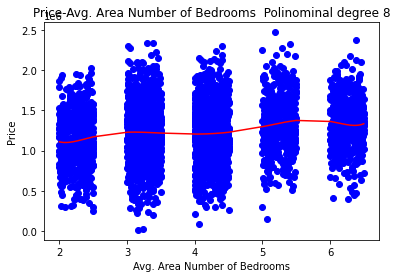

################
(4000, 10)
y_pred (4000,)
Score: 0.03728603715851386


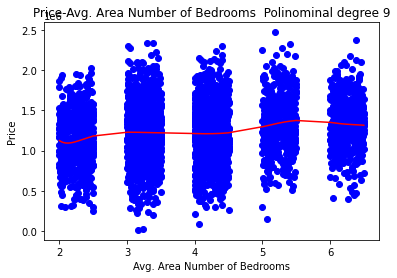

################
(4000, 11)
y_pred (4000,)
Score: 0.03774567972672749


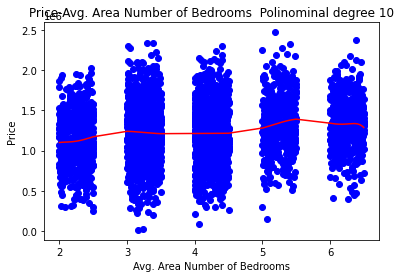

################
(4000, 3)
y_pred (4000,)
Score: 0.1658456610263993


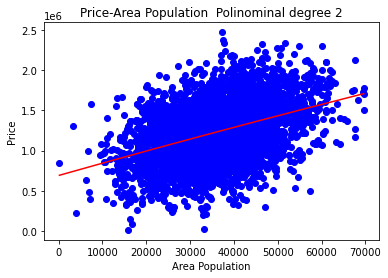

################
(4000, 4)
y_pred (4000,)
Score: 0.16588501634030295


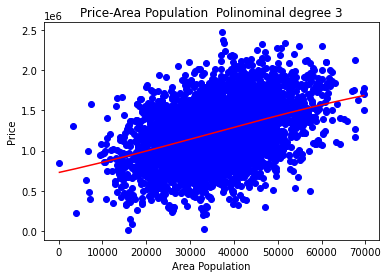

################
(4000, 5)
y_pred (4000,)
Score: 0.16575299101159102


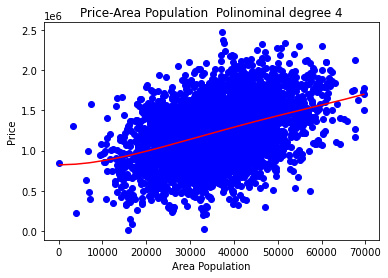

################
(4000, 6)
y_pred (4000,)
Score: 0.1649435500531392


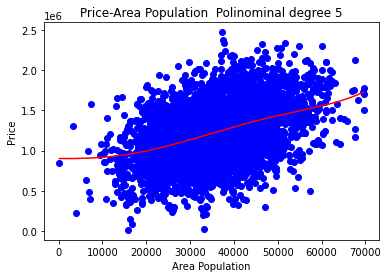

################
(4000, 7)
y_pred (4000,)
Score: 0.1630903230396057


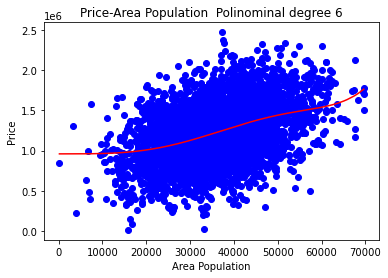

################
(4000, 8)
y_pred (4000,)
Score: 0.15997514435961635


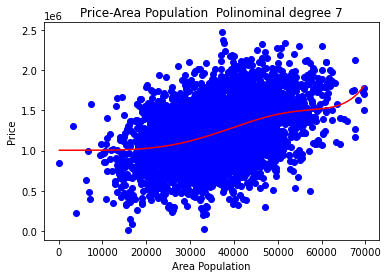

################
(4000, 9)
y_pred (4000,)
Score: 0.1555533387140272


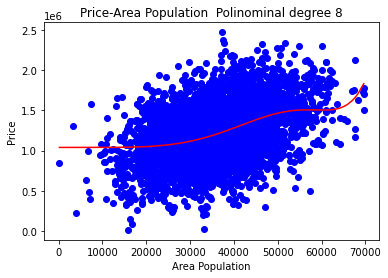

################
(4000, 10)
y_pred (4000,)
Score: 0.14992598473258278


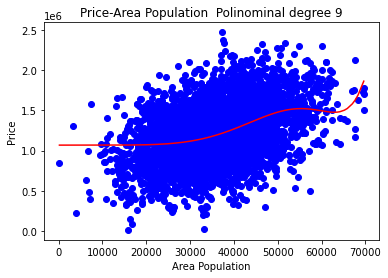

################
(4000, 11)
y_pred (4000,)
Score: 0.14327795755135997


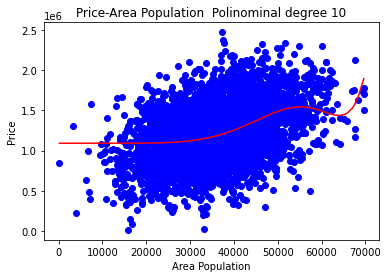

In [12]:
for elem in colum_analize:
    # Divido el conjunto de datos
    X_train, X_test, y_train, y_test = train_test_split(df[elem].values, df['Price'].values,test_size=0.2, random_state=7)
    degree_min = 2
    degree_max = 10
# Make a pipeline model with polynomial transformation and LASSO regression with cross-validation, run it for increasing degree of polynomial (complexity of the model)
    scores = []
    for degree in range(degree_min,degree_max+1):
        print("################")
        polinominal_model = PolynomialFeatures(degree) 
        X_poly = polinominal_model.fit_transform(X_train.reshape(-1, 1),y_train)

    #######
        print(X_poly.shape)

        lin_reg_model = LinearRegression()
        lin_reg_model.fit(X_poly, y_train)
        y_pred = lin_reg_model.predict(X_poly)

        print("y_pred", y_pred.shape)
        print("Score:", r2_score(y_train, y_pred))

        X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train, y_train)))
        plt.scatter(X_train_to_show, y_train_to_show, color='b')
        X_train_to_show, y_pred = zip(*sorted(zip(X_train, y_pred)))
        plt.plot(X_train_to_show, y_pred, color='red')
        plt.title("Price-"+ elem + "  Polinominal degree " + str(degree))
        plt.xlabel(elem)
        plt.ylabel('Price')
        plt.show()
 

# SVR

A partir del archivo "USA_Housing.csv", realizar la regresión no lineal entre cada columna numérica con la columna 'price' utilizando SVR

In [ ]:
Price vs. Avg. Area Number of Rooms

Utilizo el mismo split empleado en la regresión polinomial no lineal de estas dos columnas.

In [39]:
X = df['Avg. Area Number of Rooms'].values.reshape(-1,1)
y = df['Price'].values

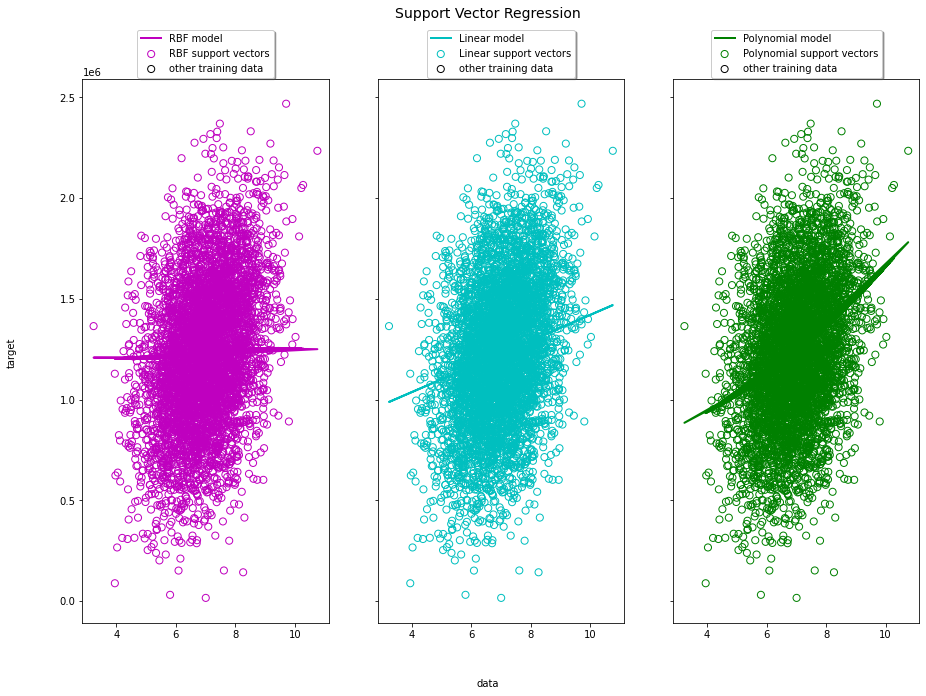

In [22]:
# Me sirve para detectar visualmente cual de los tres metodos de SVR es mejor.
# Fit regression model
svr_rbf = SVR(kernel='rbf', C=100, gamma=0.1, epsilon=.1)
svr_lin = SVR(kernel='linear', C=100, gamma='auto')
svr_poly = SVR(kernel='poly', C=100, gamma='auto', degree=3, epsilon=.1, coef0=1)
#########################################################Look at the results. Lo hago entre Price
lw = 2

svrs = [svr_rbf, svr_lin, svr_poly]
kernel_label = ['RBF', 'Linear', 'Polynomial']
model_color = ['m', 'c', 'g']

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(15, 10), sharey=True)
for ix, svr in enumerate(svrs):
    model = svr.fit(X, y)
    y_prediction = model.predict(X)
    axes[ix].plot(X, y_prediction, color=model_color[ix], lw=lw,
                  label='{} model'.format(kernel_label[ix]))
    axes[ix].scatter(X[svr.support_], y[svr.support_], facecolor="none",
                     edgecolor=model_color[ix], s=50,
                     label='{} support vectors'.format(kernel_label[ix]))
    axes[ix].scatter(X[np.setdiff1d(np.arange(len(X)), svr.support_)],
                     y[np.setdiff1d(np.arange(len(X)), svr.support_)],
                     facecolor="none", edgecolor="k", s=50,
                     label='other training data')
    axes[ix].legend(loc='upper center', bbox_to_anchor=(0.5, 1.1),
                    ncol=1, fancybox=True, shadow=True)

fig.text(0.5, 0.04, 'data', ha='center', va='center')
fig.text(0.06, 0.5, 'target', ha='center', va='center', rotation='vertical')
fig.suptitle("Support Vector Regression", fontsize=14)
plt.show()

Visualmente el mejor metodo SVR para este dataset parece ser el polinomyal model, por lo tanto lo entrenaré y luego hago el test.

Las particiones ya han sido realizadas en el ejercicio de no lineal polinomyal regresion anterior (X_train, X_test, y_train, y_test)

Price vs. Avg. Area Income
(X1_train, X1_test, y1_train, y1_test )

In [8]:
X1 = df['Avg. Area House Age'].values.reshape(-1, 1)
y1 = df['Price'].values

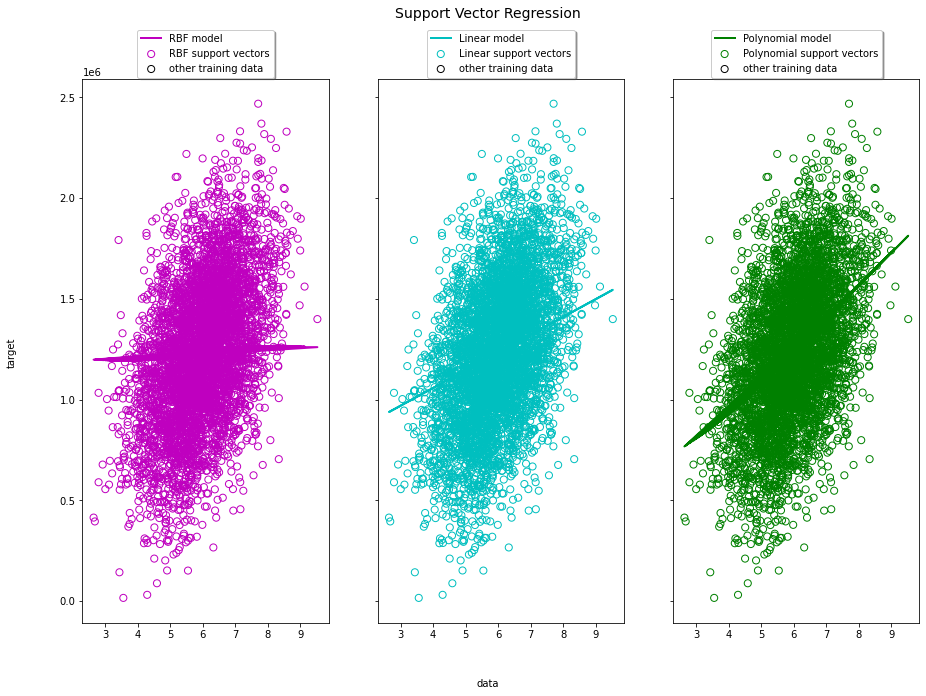

In [15]:
# Fit regression model 
svr_rbf = SVR(kernel='rbf', C=100, gamma=0.1, epsilon=.1)
svr_lin = SVR(kernel='linear', C=100, gamma='auto')
svr_poly = SVR(kernel='poly', C=100, gamma='auto', degree=3, epsilon=.1, coef0=1)
#########################################################Look at the results. Lo hago entre Price
lw = 2

svrs = [svr_rbf, svr_lin, svr_poly]
kernel_label = ['RBF', 'Linear', 'Polynomial']
model_color = ['m', 'c', 'g']

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(15, 10), sharey=True)
for ix, svr in enumerate(svrs):
    model = svr.fit(X1, y1)
    y1_prediction = model.predict(X1)
    axes[ix].plot(X1, y1_prediction, color=model_color[ix], lw=lw,
                  label='{} model'.format(kernel_label[ix]))
    axes[ix].scatter(X1[svr.support_], y1[svr.support_], facecolor="none",
                     edgecolor=model_color[ix], s=50,
                     label='{} support vectors'.format(kernel_label[ix]))
    axes[ix].scatter(X1[np.setdiff1d(np.arange(len(X1)), svr.support_)],
                     y1[np.setdiff1d(np.arange(len(X1)), svr.support_)],
                     facecolor="none", edgecolor="k", s=50,
                     label='other training data')
    axes[ix].legend(loc='upper center', bbox_to_anchor=(0.5, 1.1),
                    ncol=1, fancybox=True, shadow=True)

fig.text(0.5, 0.04, 'data', ha='center', va='center')
fig.text(0.06, 0.5, 'target', ha='center', va='center', rotation='vertical')
fig.suptitle("Support Vector Regression", fontsize=14)
plt.show()


Visualmente el mejor metodo SVR para este dataset parece ser el polinomyal model, por lo tanto lo entrenaré y luego hago el test.

Las particiones ya han sido realizadas en el ejercicio de no lineal polinomyal regresion anterior

El método de ir uno a uno es muy lento por lo que voy a crear un código que recorra todas las columnas y las compare con el target y además utilice los tres tipos de kernel  que tiene  SVR (RBF, Linear, Polynomial).

In [40]:
df_svr = df.drop(['Address'],1)
df_svr.head()

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05


In [41]:
df_X = df.drop(['Price','Address'],1)
df_X.head()

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population
0,79545.458574,5.682861,7.009188,4.09,23086.800503
1,79248.642455,6.002900,6.730821,3.09,40173.072174
2,61287.067179,5.865890,8.512727,5.13,36882.159400
3,63345.240046,7.188236,5.586729,3.26,34310.242831
4,59982.197226,5.040555,7.839388,4.23,26354.109472


In [25]:
#X_svr = df.drop(["Price",'Address'],1).values.reshape(-1,1)
#y_svr = df['Price'].values.reshape(-1,1)
#X_svr.shape

In [29]:
#Normalizo las columnas que van a ser las X
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
df_normalized = pd.DataFrame(
    data=scaler.fit_transform(df_X.values), 
    columns=df_X.columns, 
    index=df_X.index)

In [13]:
df_X['Avg. Area Income'].values.reshape(-1,1)


array([[79545.45857432],
       [79248.64245483],
       [61287.06717866],
       ...,
       [63390.6868855 ],
       [68001.33123509],
       [65510.58180367]])

In [ ]:
colum_analize = ('Avg. Area Income','Avg. Area House Age', 'Avg. Area Number of Rooms','Avg. Area Number of Bedrooms','Area Population')

In [16]:
# Con este código pruebo los tres kernel de SVR pero sin elegir ningún parámetro
columnm_kernel_info = {}
for elem in df_X.columns:
    columnm_kernel_info[elem] = []
    
    # Divido el conjunto de datos
    X_train, X_test, y_train, y_test = train_test_split(df_X[elem].values.reshape(-1,1), df_svr['Price'].values,test_size=0.2, random_state=7)
        
    scores = []
    kernel = []
    for ker in ["rbf", "linear", "poly"]:
        #print("################")

        model = SVR(kernel=ker)
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        score = r2_score(y_test, y_pred)
        #scores.append(score)
        #kernel.append(model)
        columnm_kernel_info[elem].append(ker)
        columnm_kernel_info[elem].append(score)
        #print(' Column: ',elem, '  Kernel:', ker )
        #print("y_pred:", y_pred)
        #print("Score:", score)

columnm_kernel_info


{'Avg. Area Income': ['rbf',
  0.0014570074269111277,
  'linear',
  0.4020741489353479,
  'poly',
  0.3922669212544425],
 'Avg. Area House Age': ['rbf',
  0.000718286949337843,
  'linear',
  0.003692753136604443,
  'poly',
  0.18311346670743478],
 'Avg. Area Number of Rooms': ['rbf',
  0.0002876726244226413,
  'linear',
  0.0019492226891948405,
  'poly',
  0.08125829864127354],
 'Avg. Area Number of Bedrooms': ['rbf',
  0.00010379023551287947,
  'linear',
  0.0008281345636537152,
  'poly',
  0.02925354720461104],
 'Area Population': ['rbf',
  0.0005938487607815013,
  'linear',
  0.17164849330129772,
  'poly',
  0.14918687429305966]}

In [23]:
# Con este código pruebo los tres kernel de SVR y cada uno de ellos con ciertos parámetros. He tendio que comentar el polynomial pq hace que se bloquea mi ordenador

columnm_kernel_info = {}
for elem in df_X.columns:
    columnm_kernel_info[elem] = []
    # Divido el conjunto de datos
    X_train, X_test, y_train, y_test = train_test_split(df_X[elem].values.reshape(-1,1), df_svr['Price'].values,test_size=0.9, random_state=7)
    
    svr_rbf = SVR(kernel='rbf', C=100, gamma=0.1, epsilon=.1)
    svr_lin = SVR(kernel='linear', C=100, gamma='auto')
    #svr_poly = SVR(kernel='poly', C=100, gamma='auto', degree=3, epsilon=.1, coef0=1)
#########################################################
    svrs = [svr_rbf, 
        svr_lin,
        #svr_poly
        ]

    scores = []
    kernel = []

    for model in svrs:
        #print("################")
    #######
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        score = r2_score(y_test, y_pred)
        scores.append(score)
        kernel.append(model)
        columnm_kernel_info[elem].append(model)
        columnm_kernel_info[elem].append(score)
        #print(' Column: ',elem, '  Kernel:', model )
        #print("y_pred:", y_pred)
        #print("Score:", score)

columnm_kernel_info

{'Avg. Area Income': [SVR(C=100, gamma=0.1),
  -0.014335460601729189,
  SVR(C=100, gamma='auto', kernel='linear'),
  0.40420775853025426],
 'Avg. Area House Age': [SVR(C=100, gamma=0.1),
  -0.00918810545902371,
  SVR(C=100, gamma='auto', kernel='linear'),
  0.028675618424359173],
 'Avg. Area Number of Rooms': [SVR(C=100, gamma=0.1),
  -0.01062807851477876,
  SVR(C=100, gamma='auto', kernel='linear'),
  0.0053793941580208005],
 'Avg. Area Number of Bedrooms': [SVR(C=100, gamma=0.1),
  -0.013598885027193752,
  SVR(C=100, gamma='auto', kernel='linear'),
  -0.010082105726635149],
 'Area Population': [SVR(C=100, gamma=0.1),
  -0.01432223674719979,
  SVR(C=100, gamma='auto', kernel='linear'),
  0.15751163539329782]}

### 2. Se pide:

En el anterior dataset, la columna "Avg. Area Number of Bedrooms" está en un rango numérico limitado:

1. Cambia todos los datos para que sean enteros redondeando hacia el entero más cercano. Si es .5 exacto, se redondea hacia abajo.

2. Cuando lo hayas hecho, tendras una columna con números enteros en un rango limitado. Ahora trata a esa columna como una serie de valores discretos (classes, labels). 

3. Usando las demás columnas numéricas y una a una, utiliza SVM para clasificar esa columna modificada.

4. Usando todas las demás columnas a la vez, utiliza SVM para clasificar esa columna modificada. Es decir, "Avg. Area Income" con nuestro target, después "Avg. Area House Age", ...  

5. ¿Qué columna tiene mejor correlación con "Avg. Area Number of Bedrooms" una vez modificada? ¿qué columna da mejor score para nuestro target? 

6. Utilizar todas las columnas a la vez para clasificar "Avg. Area Number of Bedrooms", ¿hace aumentar el score? ¿por qué?

## 2. 
8En el anterior dataset, la columna "Avg. Area Number of Bedrooms" está en un rango numérico limitado:

Cambia todos los datos para que sean enteros redondeando hacia el entero más cercano. Si es .5 exacto, se redondea hacia abajo.

In [42]:
import math

In [43]:
df_svr.head()

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05


In [44]:
for elem in df_svr.columns:
    df_svr[elem] = df_svr[elem].apply(lambda x: int(math.floor(x)))
df_svr.head()

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price
0,79545,5,7,4,23086,1059033
1,79248,6,6,3,40173,1505890
2,61287,5,8,5,36882,1058987
3,63345,7,5,3,34310,1260616
4,59982,5,7,4,26354,630943


2.2 Cuando lo hayas hecho, tendras una columna con números enteros en un rango limitado. Ahora trata a esa columna como una serie de valores discretos (classes, labels).

In [45]:
df_svr["Avg. Area Number of Rooms"].value_counts()

7     1708
6     1662
5      702
8      695
4      123
9      101
10       5
3        4
Name: Avg. Area Number of Rooms, dtype: int64

Usando las demás columnas numéricas y una a una, utiliza SVM para clasificar esa columna modificada.

Como se trata de un método de clasificación voy a utilizar SVM de clasificación

In [46]:
df_X_svmc = df_svr.drop(['Avg. Area Number of Bedrooms'],1)
df_X_svmc.head()

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Area Population,Price
0,79545,5,7,23086,1059033
1,79248,6,6,40173,1505890
2,61287,5,8,36882,1058987
3,63345,7,5,34310,1260616
4,59982,5,7,26354,630943


Avg. Area Income  Vs  Avg. Area Number of Bedrooms

In [47]:
X1_svmc = df_svr['Avg. Area Income'].values.reshape(-1, 1)
y1_svmc = df_svr['Avg. Area Number of Bedrooms'].values

In [20]:
X1_svmc.shape

(5000, 1)

In [21]:
y1_svmc

array([4, 3, 5, ..., 2, 5, 4], dtype=int64)

In [48]:
#Con esta función voy a elegir cual serían los mejores valores de C y gamma
def data3_params(X_train, y_train, X_test, y_test):

    C_cands = [0.03, 0.1, 0.3, 0.8, 1, 1.5, 3, 10]
    gamma_cands = [0.01, 0.03, 0.1, 0.3, 1, 3, 10, 20]
    max_score = -1
    C_pick = 0.01
    gamma_pick = -1
    for C in C_cands:
        for gamma in gamma_cands:
            clf = svm.SVC(C=C, kernel='rbf', gamma=gamma)
            clf.fit(X_train, y_train)
            score = clf.score(X_test, y_test)
            if score > max_score:
                max_score = score
                C_pick = C
                gamma_pick = gamma

    return C_pick, gamma_pick

In [49]:
# Divido el conjunto de datos
X_svmc_train, X_svmc_test, y_svmc_train, y_svmc_test = train_test_split(X1_svmc, y1_svmc,test_size=0.2, random_state=7)

In [50]:
from sklearn import svm

In [52]:
C, gamma = data3_params(X_svmc_train, y_svmc_train, X_svmc_test, y_svmc_test)

# Train the SVM
clf = svm.SVC(C=C, kernel='rbf', gamma=gamma)
clf.fit(X_svmc_train, y_svmc_train)
print ('score:', clf.score(X_svmc_test, y_svmc_test))

score: 0.311


### Utilizo grid_search para determinar que kernel y que parametros nos dan el mejor score.

In [53]:
# Load libraries
import pickle
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.model_selection import RepeatedKFold
from sklearn.model_selection import train_test_split 
# Set random seed
np.random.seed(0)

In [54]:
X_grid = df_X_svmc.values
X_grid.shape

(5000, 5)

In [55]:
y_grid = df_svr["Avg. Area Number of Rooms"].values
y_grid.shape

(5000,)

In [56]:
X_train_grid, X_test_grid, y_train_grid, y_test_grid = train_test_split(X_grid, y_grid, test_size=0.2, random_state=2)

In [57]:
to_test = np.arange(1, 10)

In [58]:
# Create a pipeline

# Le podemos poner cualquier clasificador. Irá cambiando según va probando pero necesita 1.
pipe = Pipeline(steps=[('classifier', RandomForestClassifier())])


logistic_params = {
    'classifier': [LogisticRegression()],
    'classifier__penalty': ['l1', 'l2'],
    'classifier__C': np.logspace(0, 4, 10)
    }

random_forest_params = {
    'classifier': [RandomForestClassifier()],
    'classifier__n_estimators': [10, 100, 1000],
    'classifier__max_features': [1, 2, 3]
    }

svm_params = {
    'classifier': [svm.SVC()],
    'classifier__kernel':('linear', 'rbf', 'sigmoid'), 
    'classifier__C':[0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9], 
    'classifier__degree': to_test,
    'classifier__coef0': [-10.,-1., 0., 0.1, 0.5, 1, 10, 100],
    'classifier__gamma': ('scale', 'auto')
    }


# Create space of candidate learning algorithms and their hyperparameters
search_space = [
    logistic_params,
    random_forest_params,
    #svm_params
    ]

In [59]:
%%time

cv = RepeatedKFold(n_splits=10, n_repeats=1, random_state=1)
# Create grid search 
clf = GridSearchCV(estimator=pipe, param_grid=search_space, cv=cv, verbose=10, n_jobs=-1)

# Fit grid search
best_model = clf.fit(X_train_grid, y_train_grid)
# View best model
separator = "\n############################\n"
print(separator)
print("best estimator:", best_model.best_estimator_.get_params()['classifier'])
print(separator)
print("clf.best_params_", clf.best_params_)
print(separator)
# Mean cross-validated score of the best_estimator
print("clf.best_score", clf.best_score_)
#SAVE MODEL
# save the model to disk
filename = 'finished_model.sav'
pickle.dump(best_model, open(filename, 'wb'))

Fitting 10 folds for each of 29 candidates, totalling 290 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:   22.8s
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:   22.9s
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   24.2s
[Parallel(n_jobs=-1)]: Done  24 tasks      | elapsed:   24.3s
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed:   25.2s
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:   25.8s
[Parallel(n_jobs=-1)]: Done  53 tasks      | elapsed:   26.5s
[Parallel(n_jobs=-1)]: Done  64 tasks      | elapsed:   27.3s
[Parallel(n_jobs=-1)]: Batch computation too fast (0.1970s.) Setting batch_size=2.
[Parallel(n_jobs=-1)]: Done  79 tasks      | elapsed:   28.9s
[Parallel(n_jobs=-1)]: Done 104 tasks      | elapsed:   30.5s
[Parallel(n_jobs=-1)]: Done 134 tasks      | elapsed:   34.4s
[Parallel(n_jobs=-1)]: Done 164 tasks      | elapsed:   36.1s
[Parallel(n_jobs=-1)]: Done 198 ta

In [ ]:
loaded_model = pickle.load(file="finished_model.sav")

In [ ]:
# Predict target vector
best_model.score(X_test_grid, y_test_grid) * 100